In [2]:
import pandas as pd
import glob, os
from dataprep.eda import plot_correlation
from dataprep.eda import plot
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
import datetime
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px
import seaborn as sns
from scipy import stats
from sklearn.linear_model import LinearRegression
import pandas as pd
import datacleaner
import numpy as np
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings('ignore')


import random
from matplotlib import pyplot as plt
from matplotlib import colors as mpc
plt.rcParams["font.family"] = "Poppins"
from sklearn.mixture import GaussianMixture

import seaborn as sns; sns.set()
from sklearn.metrics import r2_score 
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from gmr.utils import check_random_state
from gmr import MVN, GMM, plot_error_ellipses
random_state = check_random_state(0)

from IPython.display import clear_output

%load_ext autoreload
%autoreload 
%matplotlib inline


import plotly.express as px

import statsmodels.api as sm
from statsmodels.tools.eval_measures import rmse
#from bioinfokit.analys import get_data, stat
from statsmodels.stats.outliers_influence import variance_inflation_factor 
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression

In [3]:
os.chdir("/Volumes/GoogleDrive/My Drive/lcs/lcsdata/bydate-18lcs")


# 1. Combine LCS files

In [4]:
# concatenate raw data files downloaded from sensor

alldata = pd.DataFrame(columns=['nodeId', 'timeUtc', 'aqi', 'pm1MassConcCalib[ug/m3]',
       'pm1MassConcRaw[ug/m3]', 'pm1NumConcRaw[#/cm^3]',
       'pm2_5MassConcCalib[ug/m3]', 'pm2_5MassConcRaw[ug/m3]',
       'pm2_5NumConcRaw[#/cm^3]', 'pm10MassConcCalib[ug/m3]',
       'pm10MassConcRaw[ug/m3]', 'pm10NumConcRaw[#/cm^3]', 'no2ConcCalib[ppb]',
       'no2ConcRaw[ppb]', 'pmCoarseMassConcRaw[ug/m3]', 'so2ConcRaw[ppb]',
       'o3ConcRaw[ppb]', 'coConcRaw[ppb]', 'noConcRaw[ppb]', 'noxConcRaw[ppb]',
       'pressure[kPa]', 'dewPoint[degC]', 'internalTemperature[degC]',
       'internalRelHumidity[%]', 'tVocConc[ppb]', 'eCo2Conc[ppb]', 'latitude',
       'longitude'])

total_len = 0
for file in glob.glob("*measurements*.csv"):
    this_data = pd.read_csv(file,header=0)
    total_len += len(this_data)
    print(total_len)
    alldata = alldata.append(this_data, ignore_index=True)

24922
71850
119296
141607
164621
199067
237913
279134


In [4]:
alldata.to_csv('all_combined.csv')

# 2. Look at all the data

In [5]:
# if you have already combined the LCS files and saved them to all_combined.csv, then you can just skip the above and run this:
alldata = pd.read_csv('all_combined.csv')

In [6]:
ls #list all files in directory

A0C2V9DG.csv
A0G3PTLF.csv
A0NZTVDQ.csv
A38WP4V2.csv
A4ZTMS31.csv
A4ZTW82Y.csv
A515QB33.csv
A58F6461.csv
A7KSR29T.csv
AC93VSS1.csv
AGZF41LX.csv
AK06MKD9.csv
AN6MWGMS.csv
AR8160P8.csv
AW0DBKDH.csv
AWWC5C05.csv
AX46Z7D5.csv
AZ0HJC0J.csv
Icon?
all.csv
all_combined.csv
all_redone.csv
all_split.csv
all_split_redone.csv
measurements-Fri Jan 01 2021 00_00_00 GMT-0500 (Eastern Standard Time)-Sun Apr 25 2021 00_00_00 GMT-0400 (Eastern Daylight Time).csv
measurements-Mon Apr 01 2019 00_00_00 GMT-0400 (Eastern Daylight Time)-Thu Aug 01 2019 00_00_00 GMT-0400 (Eastern Daylight Time).csv
measurements-Sat Aug 01 2020 00_00_00 GMT-0400 (Eastern Daylight Time)-Fri Jan 01 2021 00_00_00 GMT-0500 (Eastern Standard Time).csv
measurements-Thu Aug 01 2019 00_00_00 GMT-0400 (Eastern Daylight Time)-Wed Jan 01 2020 00_00_00 GMT-0500 (Eastern Standard Time).csv
measurements-Tue Jan 01 2019 00_00_00 GMT-0500 (Eastern Standard Time)-Mon Apr 01 2019 00_00_00 GMT-0400 (Eastern Daylight Time).csv
measurements-Wed Apr

In [7]:
alldata.head() #display just the top 5 rows

,Unnamed: 0,nodeId,timeUtc,aqi,pm1MassConcCalib[ug/m3],pm1MassConcRaw[ug/m3],pm1NumConcRaw[#/cm^3],pm2_5MassConcCalib[ug/m3],pm2_5MassConcRaw[ug/m3],pm2_5NumConcRaw[#/cm^3],...,noConcRaw[ppb],noxConcRaw[ppb],pressure[kPa],dewPoint[degC],internalTemperature[degC],internalRelHumidity[%],tVocConc[ppb],eCo2Conc[ppb],latitude,longitude
0,0,AGZF41LX,2019-04-01T04:00:00.000Z,67.0,NaN,19.95,NaN,NaN,31.19,39.85,...,NaN,NaN,NaN,NaN,29.73,76.37,NaN,NaN,0.00000,0.00000
1,1,AC93VSS1,2019-04-01T04:00:00.000Z,57.0,NaN,14.17,NaN,NaN,22.61,28.26,...,NaN,NaN,NaN,NaN,29.71,76.92,NaN,NaN,5.57342,-0.27936
2,2,AN6MWGMS,2019-04-01T04:00:00.000Z,12.0,NaN,0.00,NaN,NaN,0.00,0.38,...,NaN,NaN,NaN,NaN,29.11,80.28,NaN,NaN,0.00000,0.00000
3,3,AR8160P8,2019-04-01T04:00:00.000Z,58.0,NaN,13.53,NaN,NaN,23.65,27.84,...,NaN,NaN,NaN,NaN,28.50,81.21,NaN,NaN,5.56825,-0.24088
4,4,AWWC5C05,2019-04-01T04:00:00.000Z,63.0,NaN,18.43,NaN,NaN,27.95,36.03,...,NaN,NaN,NaN,NaN,29.53,78.30,NaN,NaN,5.55406,-0.30879


In [8]:
alldata #display all rows

,Unnamed: 0,nodeId,timeUtc,aqi,pm1MassConcCalib[ug/m3],pm1MassConcRaw[ug/m3],pm1NumConcRaw[#/cm^3],pm2_5MassConcCalib[ug/m3],pm2_5MassConcRaw[ug/m3],pm2_5NumConcRaw[#/cm^3],...,noConcRaw[ppb],noxConcRaw[ppb],pressure[kPa],dewPoint[degC],internalTemperature[degC],internalRelHumidity[%],tVocConc[ppb],eCo2Conc[ppb],latitude,longitude
0,0,AGZF41LX,2019-04-01T04:00:00.000Z,67.0,NaN,19.95,NaN,NaN,31.19,39.85,...,NaN,NaN,NaN,NaN,29.73,76.37,NaN,NaN,0.00000,0.00000
1,1,AC93VSS1,2019-04-01T04:00:00.000Z,57.0,NaN,14.17,NaN,NaN,22.61,28.26,...,NaN,NaN,NaN,NaN,29.71,76.92,NaN,NaN,5.57342,-0.27936
2,2,AN6MWGMS,2019-04-01T04:00:00.000Z,12.0,NaN,0.00,NaN,NaN,0.00,0.38,...,NaN,NaN,NaN,NaN,29.11,80.28,NaN,NaN,0.00000,0.00000
3,3,AR8160P8,2019-04-01T04:00:00.000Z,58.0,NaN,13.53,NaN,NaN,23.65,27.84,...,NaN,NaN,NaN,NaN,28.50,81.21,NaN,NaN,5.56825,-0.24088
4,4,AWWC5C05,2019-04-01T04:00:00.000Z,63.0,NaN,18.43,NaN,NaN,27.95,36.03,...,NaN,NaN,NaN,NaN,29.53,78.30,NaN,NaN,5.55406,-0.30879
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279129,279129,A0NZTVDQ,2019-04-01T04:00:00.000Z,41.0,NaN,7.18,NaN,NaN,13.24,15.65,...,NaN,NaN,NaN,NaN,29.82,77.83,NaN,NaN,5.57596,-0.22326
279130,279130,AGZF41LX,2019-04-01T04:00:00.000Z,67.0,NaN,19.95,NaN,NaN,31.19,39.85,...,NaN,NaN,NaN,NaN,29.73,76.37,NaN,NaN,0.00000,0.00000
279131,279131,A4ZTW82Y,2019-04-01T04:00:00.000Z,53.0,NaN,12.79,NaN,NaN,19.32,24.75,...,NaN,NaN,NaN,NaN,29.42,85.13,NaN,NaN,5.56080,-1.14399
279132,279132,AWWC5C05,2019-04-01T04:00:00.000Z,63.0,NaN,18.43,NaN,NaN,27.95,36.03,...,NaN,NaN,NaN,NaN,29.53,78.30,NaN,NaN,5.55406,-0.30879


In [9]:
node_list = alldata['nodeId'].unique()

In [10]:
alldata = alldata[alldata.columns[~alldata.isnull().all()]] #remove columns with NaN

# 3. Make Node-specific Files

In [11]:
# make node specific csv files 

for node in node_list:
    print(node)
    node_data = alldata[alldata['nodeId']==node]
    name = str(node) + ".csv"
    node_data.to_csv(name)

AGZF41LX
AC93VSS1
AN6MWGMS
AR8160P8
AWWC5C05
A4ZTW82Y
AK06MKD9
A4ZTMS31
AW0DBKDH
A0NZTVDQ
A0G3PTLF
AZ0HJC0J
A7KSR29T
A515QB33
A58F6461
A38WP4V2
A0C2V9DG
AX46Z7D5


In [12]:
# move all node-specific file to a separate folder

# 4. Exploratory Data Analysis

In [13]:
alldata['localtime'] = pd.to_datetime(alldata['timeUtc']) #convert timestamp column to pandas timestamp format

In [14]:
alldata['Year'] = alldata['localtime'].dt.year

In [15]:
fig = go.Figure() #this figure is heavy on the kernel, so if it disappears, go to kernel --> restart then run the above cells again from step 2

for node in node_list:
    fig.add_trace(go.Violin(x=alldata['nodeId'][alldata['nodeId'] == node],
                            y=alldata['pm2_5MassConcRaw[ug/m3]'][alldata['nodeId'] == node],
                            name=node,
                            box_visible=True,
                            meanline_visible=True))

fig.update_layout(
    title_text="pm2_5MassConcRaw[ug/m3] -- distribution")
fig.show()

# 5. Concatenate PA Embassy Data

In [16]:
os.chdir("/Volumes/GoogleDrive/My Drive/lcs/lcsdata/pa_embassy/data/")

In [17]:
pa_sample = pd.read_csv("/Volumes/GoogleDrive/My Drive/lcs/lcsdata/pa_embassy/data/20190731.csv")

In [18]:
pa_sample.head()

,UTCDateTime,mac_address,firmware_ver,hardware,current_temp_f,current_humidity,current_dewpoint_f,pressure,adc,mem,...,pm10_0_cf_1_b,pm2.5_aqi_atm_b,pm2.5_aqi_cf_1_b,p_0_3_um_b,p_0_5_um_b,p_1_0_um_b,p_2_5_um_b,p_5_0_um_b,p_10_0_um_b,gas
0,2019/07/31T16:43:26z,84:f3:eb:28:ab:17,4.02,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,78,31,45,867.59,0.02,22872,...,6,6,406.73,116.46,12.34,2.08,0.90,0.90,NaN,NaN
1,2019/07/31T16:45:25z,84:f3:eb:28:ab:17,4.02,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,78,31,45,867.65,0.02,22616,...,8,8,421.93,125.29,13.90,2.14,0.91,0.57,NaN,NaN
2,2019/07/31T16:47:25z,84:f3:eb:28:ab:17,4.02,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,78,31,45,867.60,0.02,22616,...,9,9,450.36,127.26,13.36,1.52,0.91,0.52,NaN,NaN
3,2019/07/31T16:49:25z,84:f3:eb:28:ab:17,4.02,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,78,31,45,867.61,0.02,22616,...,7,7,423.63,119.94,18.06,3.31,2.03,1.16,NaN,NaN
4,2019/07/31T16:51:25z,84:f3:eb:28:ab:17,4.02,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,79,31,46,867.61,0.02,22616,...,6,6,363.04,100.99,13.07,1.80,0.43,0.00,NaN,NaN


In [19]:
pa_sample.columns

Index(['UTCDateTime', 'mac_address', 'firmware_ver', 'hardware',
       'current_temp_f', 'current_humidity', 'current_dewpoint_f', 'pressure',
       'adc', 'mem', 'rssi', 'uptime', 'hardwareversion', 'pm1_0_atm',
       'pm2_5_atm', 'pm10_0_atm', 'pm1_0_cf_1', 'pm2_5_cf_1', 'pm10_0_cf_1',
       'pm2.5_aqi_atm', 'pm2.5_aqi_cf_1', 'p_0_3_um', 'p_0_5_um', 'p_1_0_um',
       'p_2_5_um', 'p_5_0_um', 'p_10_0_um', 'pm1_0_atm_b', 'pm2_5_atm_b',
       'pm10_0_atm_b', 'pm1_0_cf_1_b', 'pm2_5_cf_1_b', 'pm10_0_cf_1_b',
       'pm2.5_aqi_atm_b', 'pm2.5_aqi_cf_1_b', 'p_0_3_um_b', 'p_0_5_um_b',
       'p_1_0_um_b', 'p_2_5_um_b', 'p_5_0_um_b', 'p_10_0_um_b', 'gas'],
      dtype='object')

In [20]:
all_pa_embassy = pd.DataFrame(columns=pa_sample.columns)
all_pa_embassy #make base dataframe with column names, and in the next step we add all embassy data to this

,UTCDateTime,mac_address,firmware_ver,hardware,current_temp_f,current_humidity,current_dewpoint_f,pressure,adc,mem,...,pm10_0_cf_1_b,pm2.5_aqi_atm_b,pm2.5_aqi_cf_1_b,p_0_3_um_b,p_0_5_um_b,p_1_0_um_b,p_2_5_um_b,p_5_0_um_b,p_10_0_um_b,gas


In [21]:
total_len = 0
for file in glob.glob("*.csv"):
    this_data = pd.read_csv(file,header=0)
    #print(this_data.columns == pa_sample.columns)
    total_len += len(this_data)
    print(total_len)
    all_pa_embassy = all_pa_embassy.append(this_data, ignore_index=True)

719
1437
2155
2874
3592
4310
4954
5672
6318
7036
7754
8471
9190
9911
10629
11348
12070
12713
13433
14152
14870
15588
16231
16948
17595
18315
18370
19092
19813
20532
21250
21969
22002
22724
23442
24162
47143
47864
48586
49305
50024
50745
51463
52182
52901
53620
54341
55062
55780
56498
57217
57937
58656
59377
60023
60740
61460
62179
62898
63617
64336
65054
65773
66493
67212
67928
68646
69368
70085
70805
71522
72174
72892
73611
74255
74972
75691
76338
77057
77776
78495
78848
79568
80286
81008
81726
82377
83098
83815
84537
85256
85974
86692
87335
88053
88772
89493
90214
90933
91651
92368
93090
93808
94530
95251
95972
96692
97411
98130
98850
99570
100288
101010
101650
102369
103088
103809
104527
105249
105894
106613
107335
108053
108771
109488
110206
110925
111646
112290
112937
113655
114374
115094
115738
116456
117178
117898
118616
119334
120007
120726
121444
122088
122733
123452
124170
124813
125532
126250
126895
127617
128337
129056
129774
130493
131138
131857
132577
133298
134019
134740

In [22]:
all_pa_embassy.to_csv('all_pa_embassy.csv') # once you save it, in the future you can just load it from the line below instead of remaking it every time

In [23]:
all_pa_embassy = pd.read_csv('all_pa_embassy.csv')

In [24]:
all_pa_embassy

,Unnamed: 0.2,UTCDateTime,mac_address,firmware_ver,hardware,current_temp_f,current_humidity,current_dewpoint_f,pressure,adc,...,15.93.1,56,56.1,1809.04,537.97,91.63,5.85,1.40,0.51,Unnamed: 0
0,0,2020/06/13T00:00:34z,84:f3:eb:28:ab:17,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,85.0,67.0,73.0,1009.70,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,2020/06/13T00:02:33z,84:f3:eb:28:ab:17,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,85.0,67.0,73.0,1009.66,0.02,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,2020/06/13T00:04:33z,84:f3:eb:28:ab:17,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,83.0,67.0,71.0,1007.77,0.02,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,2020/06/13T00:06:33z,84:f3:eb:28:ab:17,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,85.0,67.0,73.0,1009.63,0.02,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,2020/06/13T00:08:33z,84:f3:eb:28:ab:17,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,85.0,68.0,73.0,1009.65,0.02,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
512170,512170,2020/08/18T23:51:05z,84:f3:eb:28:ab:17,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,82.0,68.0,70.0,1008.88,0.02,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
512171,512171,2020/08/18T23:53:05z,84:f3:eb:28:ab:17,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,82.0,68.0,70.0,1008.88,0.02,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
512172,512172,2020/08/18T23:55:05z,84:f3:eb:28:ab:17,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,82.0,68.0,70.0,1008.92,0.02,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
512173,512173,2020/08/18T23:57:05z,84:f3:eb:28:ab:17,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,82.0,68.0,70.0,1008.87,0.02,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [25]:
all_pa_embassy.drop(['mac_address'],axis=1) #drop columns we are not using

,Unnamed: 0.2,UTCDateTime,firmware_ver,hardware,current_temp_f,current_humidity,current_dewpoint_f,pressure,adc,mem,...,15.93.1,56,56.1,1809.04,537.97,91.63,5.85,1.40,0.51,Unnamed: 0
0,0,2020/06/13T00:00:34z,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,85.0,67.0,73.0,1009.70,NaN,36656.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,2020/06/13T00:02:33z,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,85.0,67.0,73.0,1009.66,0.02,36568.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,2020/06/13T00:04:33z,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,83.0,67.0,71.0,1007.77,0.02,36568.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,2020/06/13T00:06:33z,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,85.0,67.0,73.0,1009.63,0.02,36568.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,2020/06/13T00:08:33z,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,85.0,68.0,73.0,1009.65,0.02,36568.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
512170,512170,2020/08/18T23:51:05z,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,82.0,68.0,70.0,1008.88,0.02,36568.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
512171,512171,2020/08/18T23:53:05z,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,82.0,68.0,70.0,1008.88,0.02,36568.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
512172,512172,2020/08/18T23:55:05z,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,82.0,68.0,70.0,1008.92,0.02,36568.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
512173,512173,2020/08/18T23:57:05z,4.1,2.0+OPENLOG+15802 MB+DS3231+BME280+PMSX003-B+P...,82.0,68.0,70.0,1008.87,0.02,36568.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [26]:
all_pa_embassy.columns

Index(['Unnamed: 0.2', 'UTCDateTime', 'mac_address', 'firmware_ver',
       'hardware', 'current_temp_f', 'current_humidity', 'current_dewpoint_f',
       'pressure', 'adc',
       ...
       '15.93.1', '56', '56.1', '1809.04', '537.97', '91.63', '5.85', '1.40',
       '0.51', 'Unnamed: 0'],
      dtype='object', length=215)

# 6. PA vs BAM comparison

In [27]:
bam_2020 = pd.read_csv('/Volumes/GoogleDrive/My Drive/lcs/lcsdata/referencegrade-embassy/Accra_PM2.5_2020.csv') #these are hourly averages
bam_2021 = pd.read_csv('/Volumes/GoogleDrive/My Drive/lcs/lcsdata/referencegrade-embassy/Accra_PM2.5_2021_YTD.csv')


In [28]:
pa_embassy = pd.read_csv("/Volumes/GoogleDrive/My Drive/lcs/lcsdata/pa_embassy/data/all_pa_embassy.csv") #this is missing 5 days of data, pls add

In [30]:
# hourly averaging of PA
pa_embassy['cleanedtime'] = pa_embassy['UTCDateTime']
pa_embassy = pa_embassy[pa_embassy['UTCDateTime'].str.contains('\x1a') == False]
#pa_embassy['cleanedtime'][pa_embassy['UTCDateTime'].str.contains('\x1a')] = np.NaN
pa_embassy['localtime'] = pd.to_datetime(pa_embassy['cleanedtime'], utc=True) #accra is in GMT, GMT is the same as UTC



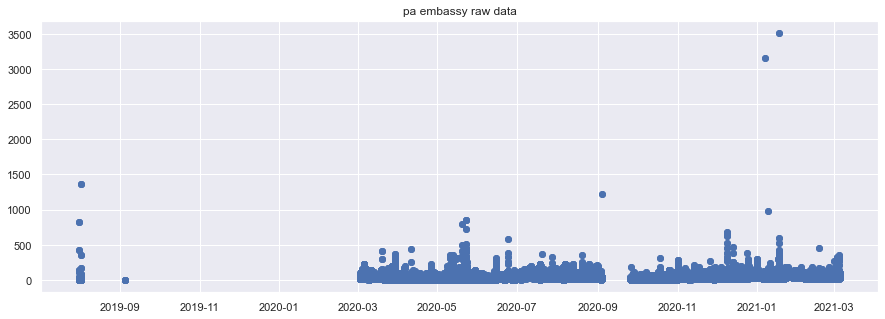

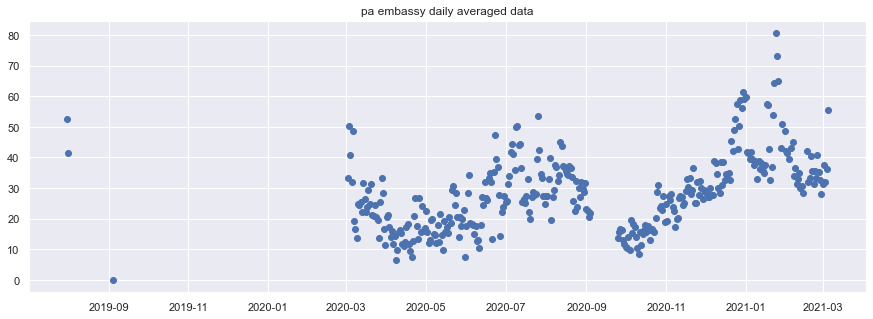

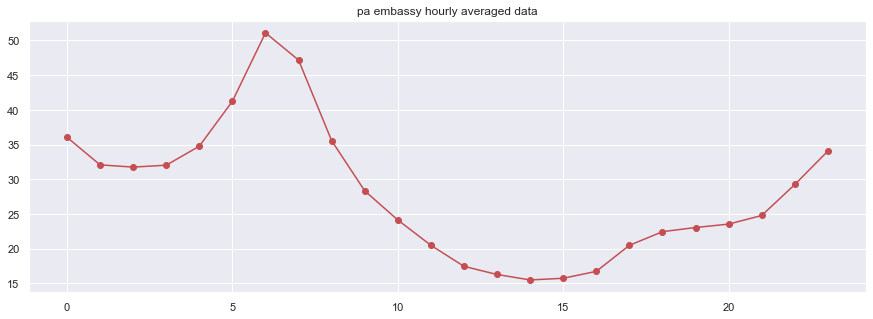

In [31]:
node = 'pa embassy'
plt.figure(figsize=(15,5))
plt.scatter(pa_embassy['localtime'],pa_embassy['pm2_5_atm'])
plt.title(str(node) + ' raw data')
plt.show()
    
    
node_avgd = pa_embassy.groupby(pa_embassy['localtime'].dt.date).mean()
plt.figure(figsize=(15,5))
plt.scatter(node_avgd.index,node_avgd['pm2_5_atm'])
plt.title(str(node) + ' daily averaged data')
plt.show()
    
node_avgd_hour = pa_embassy.groupby(pa_embassy['localtime'].dt.hour).mean()
plt.figure(figsize=(15,5))
plt.plot(node_avgd_hour.index,node_avgd_hour['pm2_5_atm'], 'ro-')
plt.title(str(node) + ' hourly averaged data')
plt.show()

In [32]:
pa_embassy_hourly = pa_embassy.resample('H', on='localtime').mean()
pa_embassy_hourly

,Unnamed: 0.2,firmware_ver,current_temp_f,current_humidity,current_dewpoint_f,pressure,adc,mem,rssi,uptime,...,15.93.1,56,56.1,1809.04,537.97,91.63,5.85,1.40,0.51,Unnamed: 0
localtime,,,,,,,,,,,,,,,,,,,,,
2019-07-31 16:00:00+00:00,116181.250000,4.02,78.750000,30.875000,45.375000,867.592500,0.020000,22680.000000,-49.875000,1117.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,43868.250000
2019-07-31 17:00:00+00:00,116197.043478,4.02,83.434783,25.956522,44.869565,867.457391,0.020435,22667.826087,-51.043478,3012.304348,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,43884.043478
2019-07-31 18:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-07-31 19:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-07-31 20:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-03-05 07:00:00+00:00,275589.000000,4.10,88.120000,62.240000,73.280000,1006.244800,0.020000,36411.520000,-87.600000,716.360000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69403.000000
2021-03-05 08:00:00+00:00,275615.240000,4.10,93.240000,55.200000,74.360000,1006.850400,0.020000,36524.480000,-87.240000,754.480000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69429.240000
2021-03-05 09:00:00+00:00,275642.115385,4.10,96.923077,48.307692,73.923077,1007.043462,0.020000,36504.000000,-78.538462,738.846154,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69456.115385


In [33]:
bam_2020['localtime'] = pd.to_datetime(bam_2020['Date (LT)'], utc=True)
bam_2021['localtime'] = pd.to_datetime(bam_2021['Date (LT)'], utc=True)
bam_all = bam_2020.append(bam_2021, ignore_index=True)


In [34]:
# merge PA and BAM
bam_pa = bam_all.merge(pa_embassy_hourly, left_on='localtime', right_on='localtime')


In [35]:
bam_pa

,Site,Parameter,Date (LT),Year,Month,Day,Hour,NowCast Conc.,AQI,AQI Category,...,15.93.1,56,56.1,1809.04,537.97,91.63,5.85,1.40,0.51,Unnamed: 0
0,Accra,PM2.5 - Principal,2020-01-27 04:00 PM,2020,1,27,16,-999.0,-999,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Accra,PM2.5 - Principal,2020-01-27 06:00 PM,2020,1,27,18,-999.0,-999,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Accra,PM2.5 - Principal,2020-01-27 07:00 PM,2020,1,27,19,-999.0,-999,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Accra,PM2.5 - Principal,2020-01-27 08:00 PM,2020,1,27,20,-999.0,-999,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Accra,PM2.5 - Principal,2020-01-27 09:00 PM,2020,1,27,21,-999.0,-999,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9556,Accra,PM2.5 - Principal,2021-03-05 07:00 AM,2021,3,5,7,53.7,146,Unhealthy for Sensitive Groups,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69403.000000
9557,Accra,PM2.5 - Principal,2021-03-05 08:00 AM,2021,3,5,8,55.9,151,Unhealthy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69429.240000
9558,Accra,PM2.5 - Principal,2021-03-05 09:00 AM,2021,3,5,9,51.9,141,Unhealthy for Sensitive Groups,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69456.115385
9559,Accra,PM2.5 - Principal,2021-03-05 10:00 AM,2021,3,5,10,46.9,129,Unhealthy for Sensitive Groups,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69482.846154


In [36]:
bam_pa_cleaned = bam_pa[bam_pa['Raw Conc.'] > 0]
bam_pa_cleaned = bam_pa_cleaned[bam_pa_cleaned['p_2_5_um'].notna()]


(-5.0, 300.0)

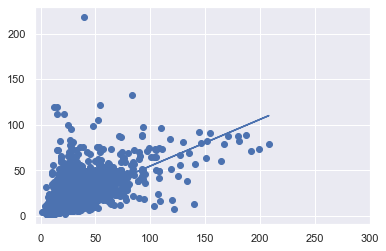

In [37]:
# linear regression on bam and pa
plt.scatter(bam_pa_cleaned['Raw Conc.'], bam_pa_cleaned['p_2_5_um'])
m, b = np.polyfit(bam_pa_cleaned['Raw Conc.'], bam_pa_cleaned['p_2_5_um'],1)


plt.plot(bam_pa_cleaned['Raw Conc.'], m*bam_pa_cleaned['Raw Conc.'] + b)
plt.xlim(-5,300)

In [38]:
def r2(x, y):
    return stats.pearsonr(x, y)[0] ** 2


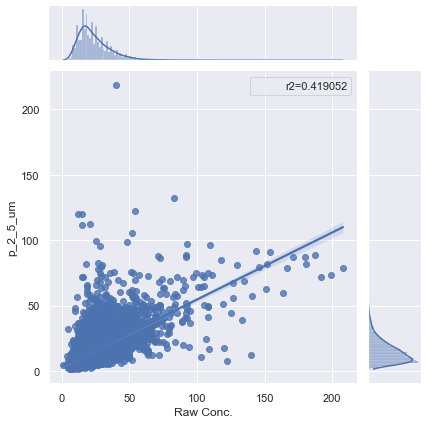

In [39]:
graph = sns.jointplot(bam_pa_cleaned['Raw Conc.'], bam_pa_cleaned['p_2_5_um'], kind="reg")

r2_val = r2(bam_pa_cleaned['Raw Conc.'], bam_pa_cleaned['p_2_5_um'])

phantom, = graph.ax_joint.plot([], [], linestyle="", alpha=0)
# here graph is not a ax but a joint grid, so we access the axis through ax_joint method

graph.ax_joint.legend([phantom],['r2={:f}'.format(r2_val)])

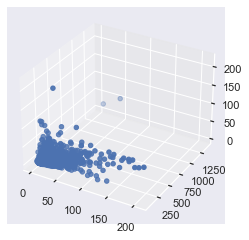

In [40]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter3D(bam_pa_cleaned['Raw Conc.'], bam_pa_cleaned['current_temp_f'],bam_pa_cleaned['p_2_5_um'])


In [41]:
# some mild data cleaning 

bam_pa_cleaned = bam_pa[bam_pa['current_temp_f'] < 120]
bam_pa_cleaned = bam_pa_cleaned[bam_pa_cleaned['Raw Conc.'] > 0]
bam_pa_cleaned = bam_pa_cleaned[bam_pa_cleaned['current_humidity'] < 100]
bam_pa_cleaned = bam_pa_cleaned[bam_pa_cleaned['p_2_5_um'].notna()]
bam_pa_cleaned = bam_pa_cleaned[bam_pa_cleaned['pm2_5_atm'].notna()]
bam_pa_cleaned = bam_pa_cleaned[bam_pa_cleaned['pm2_5_atm_b'].notna()]
bam_pa_cleaned = bam_pa_cleaned[bam_pa_cleaned['current_humidity'].notna()]
bam_pa_cleaned = bam_pa_cleaned[bam_pa_cleaned['current_temp_f'].notna()]
bam_pa_cleaned = bam_pa_cleaned[bam_pa_cleaned['current_temp_f'].notna()]
bam_pa_cleaned = bam_pa_cleaned[bam_pa_cleaned['pressure'].notna()]
bam_pa_cleaned = bam_pa_cleaned[bam_pa_cleaned['Raw Conc.'].notna()]
bam_pa_cleaned

,Site,Parameter,Date (LT),Year,Month,Day,Hour,NowCast Conc.,AQI,AQI Category,...,15.93.1,56,56.1,1809.04,537.97,91.63,5.85,1.40,0.51,Unnamed: 0
826,Accra,PM2.5 - Principal,2020-03-02 12:00 PM,2020,3,2,12,69.2,158,Unhealthy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,65269.904762
827,Accra,PM2.5 - Principal,2020-03-02 01:00 PM,2020,3,2,13,53.6,146,Unhealthy for Sensitive Groups,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,65295.678571
828,Accra,PM2.5 - Principal,2020-03-02 02:00 PM,2020,3,2,14,50.3,137,Unhealthy for Sensitive Groups,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,65326.259259
829,Accra,PM2.5 - Principal,2020-03-02 03:00 PM,2020,3,2,15,43.1,120,Unhealthy for Sensitive Groups,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,65356.071429
830,Accra,PM2.5 - Principal,2020-03-02 04:00 PM,2020,3,2,16,38.5,108,Unhealthy for Sensitive Groups,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,65385.357143
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9556,Accra,PM2.5 - Principal,2021-03-05 07:00 AM,2021,3,5,7,53.7,146,Unhealthy for Sensitive Groups,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69403.000000
9557,Accra,PM2.5 - Principal,2021-03-05 08:00 AM,2021,3,5,8,55.9,151,Unhealthy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69429.240000
9558,Accra,PM2.5 - Principal,2021-03-05 09:00 AM,2021,3,5,9,51.9,141,Unhealthy for Sensitive Groups,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69456.115385
9559,Accra,PM2.5 - Principal,2021-03-05 10:00 AM,2021,3,5,10,46.9,129,Unhealthy for Sensitive Groups,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69482.846154


In [42]:
fig = px.scatter(bam_pa_cleaned, x='Raw Conc.', y='p_2_5_um',
              color='current_humidity')
fig.show()

In [43]:
fig = px.scatter_3d(bam_pa_cleaned, x='Raw Conc.', y='p_2_5_um', z='current_humidity',
              color='current_temp_f')
fig.show()

# 7. Multiple Linear Regression (MLR)

In [44]:
y = bam_pa_cleaned['Raw Conc.']
x = bam_pa_cleaned[['pm2_5_atm','p_2_5_um','pm2_5_atm_b','current_humidity','current_temp_f', 'pressure']]

In [45]:
linear_regression = LinearRegression()
linear_regression.fit(x,y)
y_pred = linear_regression.predict(x)

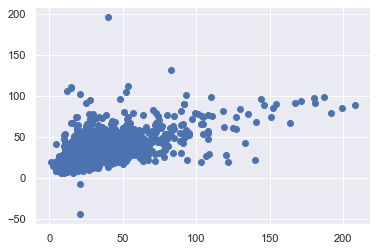

In [46]:
plt.scatter(y, y_pred)

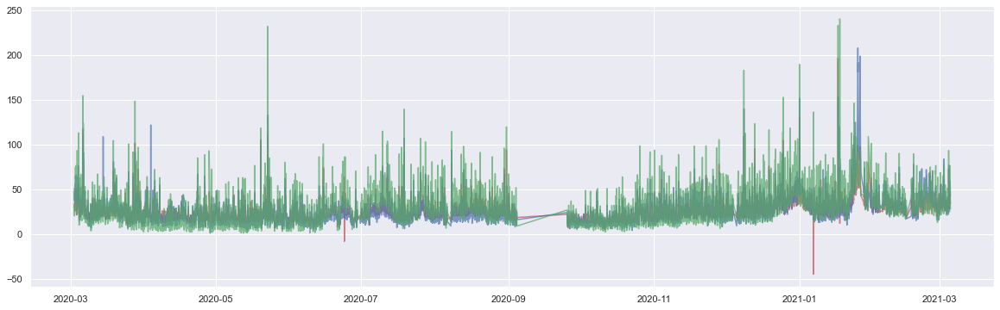

In [47]:
plt.figure(figsize=(20, 6))
plt.plot(bam_pa_cleaned['localtime'], y_pred,'r-', alpha=0.7)
plt.plot(bam_pa_cleaned['localtime'],bam_pa_cleaned['Raw Conc.'],'b-', alpha=0.7)
plt.plot(bam_pa_cleaned['localtime'],bam_pa_cleaned['pm2_5_atm'],'g-', alpha=0.7)

In [48]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=bam_pa_cleaned['localtime'], y=np.abs(bam_pa_cleaned['pm2_5_atm']- bam_pa_cleaned['Raw Conc.']),
                    mode='lines',
                    name='Raw Error',
                    line=dict(color='rgba(0, 0, 255, 0.5)')))

fig.add_trace(go.Scatter(x=bam_pa_cleaned['localtime'], y=np.abs(y_pred - bam_pa_cleaned['Raw Conc.']),
                    mode='lines',
                    name='MLR Error',
                    line=dict(color='rgba(255, 0, 0, 0.5)')))




fig.show()



In [49]:
# manually calculate mean absolute error
np.sum(np.abs(y_pred - bam_pa_cleaned['Raw Conc.']))/len(bam_pa_cleaned['Raw Conc.'])


6.299868267839066

In [50]:
np.sum(np.abs(bam_pa_cleaned['pm2_5_atm']- bam_pa_cleaned['Raw Conc.']))/len(bam_pa_cleaned['Raw Conc.'])

10.542515551683177

In [51]:
# MAE brought down 40%

In [52]:
linear_regression.get_params()
linear_regression.score(bam_pa_cleaned[['pm2_5_atm','p_2_5_um','pm2_5_atm_b','current_humidity','current_temp_f', 'pressure']],bam_pa_cleaned['Raw Conc.'])

0.5065535976525724

In [53]:
linear_regression.coef_

array([-0.63459097,  0.75972035,  0.69565961, -0.23619119,  0.26109813,
       -0.15332956])

In [54]:
linear_regression.intercept_

155.55232051679099

In [55]:
hourly_coeffs = [86.9,0.55,-1.28,-0.55]

bam_pa_cleaned['corrected_kinshasa'] = hourly_coeffs[0] + hourly_coeffs[1]*bam_pa_cleaned['pm2_5_atm'] + hourly_coeffs[2]*bam_pa_cleaned['current_temp_f'] + hourly_coeffs[3]*bam_pa_cleaned['current_humidity']

In [56]:
hourly_coeffs = linear_regression.coef_
x = bam_pa_cleaned[['pm2_5_atm','p_2_5_um','pm2_5_atm_b','current_humidity','current_temp_f', 'pressure']]
y_pred = linear_regression.predict(x)

bam_pa_cleaned['corrected_accra'] = y_pred

fig = make_subplots(rows=2, cols=1,shared_xaxes=True)

fig.add_trace(go.Scatter(x=bam_pa_cleaned.index, y=bam_pa_cleaned['Raw Conc.'],
                    mode='lines',
                    name='BAM Raw Conc',
                    line=dict(color='rgba(255, 0, 0, 0.5)')),row=1,col=1)
fig.add_trace(go.Scatter(x=bam_pa_cleaned.index, y=bam_pa_cleaned['corrected_kinshasa'],
                    mode='lines',
                    name='Kinshasa correction',
                    line=dict(color='rgba(0, 255, 0, 0.5)')),row=1,col=1)
fig.add_trace(go.Scatter(x=bam_pa_cleaned.index, y=bam_pa_cleaned['pm2_5_atm'],
                    mode='lines',
                    name='PA Raw',
                    line=dict(color='rgba(0, 0, 255, 0.5)')),row=1,col=1)
fig.add_trace(go.Scatter(x=bam_pa_cleaned.index, y=bam_pa_cleaned['corrected_accra'],
                    mode='lines',
                    name='Accra correction',
                    line=dict(color='rgba(0, 255, 255, 0.5)')),row=1,col=1)
fig.add_trace(go.Scatter(x=bam_pa_cleaned.index, y=np.abs(bam_pa_cleaned['corrected_accra']-bam_pa_cleaned['Raw Conc.']),
                    mode='lines',
                    name='Accra correction difference',
                    line=dict(color='rgba(100,100,100, 0.5)')),row=2,col=1)
fig.add_trace(go.Scatter(x=bam_pa_cleaned.index, y=np.abs(bam_pa_cleaned['corrected_kinshasa']-bam_pa_cleaned['Raw Conc.']),
                    mode='lines',
                    name='Kinshasa correction difference',
                    line=dict(color='rgba(50,20,30, 0.5)')),row=2,col=1)


fig.show()
           



In [57]:
np.sum(np.abs(bam_pa_cleaned['corrected_accra']-bam_pa_cleaned['Raw Conc.']))/len(bam_pa_cleaned) # mean absolute error

6.299868267839066

In [58]:
np.sum(np.abs(bam_pa_cleaned['corrected_kinshasa']-bam_pa_cleaned['Raw Conc.']))/len(bam_pa_cleaned) # mean absolute error

68.62621845576254

In [59]:
# so the kinshasa MLR regression doesnt apply very well to accra, but the accra MLR obviously works well

In [60]:
bam_pa_cleaned.to_csv('bam_pa_cleaned.csv')

# 8. Gaussian Mixture Regression (GMR)

In [61]:
pa_raw_path = '/Volumes/GoogleDrive/My Drive/lcs/lcsdata/pa_embassy/data/all_pa_embassy_clean.csv'
clarity_raw_path = '/Volumes/GoogleDrive/My Drive/lcs/lcsdata/bydate-18lcs/all_split_redone.csv'
bam_raw_path = '/Volumes/GoogleDrive/My Drive/lcs/lcsdata/referencegrade-embassy/Accra_PM2.5_2020.csv'


In [62]:
clarity_cleaned, removed_rows = datacleaner.clean_clarity(clarity_raw_path)


In [63]:
pa_cleaned, removed_rows_pa = datacleaner.clean_pa(pa_raw_path)


In [64]:
bam_cleaned, bam_og, bam_ognonan, bam_fl, bam_pr, bam_npr = datacleaner.clean_bam(bam_raw_path)
print(bam_og, bam_ognonan, bam_fl, bam_pr, bam_npr)

8047 8047 7849 0.024605443022244315 0.0


In [65]:
node_list = clarity_cleaned['stationName'].unique()

In [66]:
df = pd.DataFrame()
for node in node_list:
    print(node)
    node_data = clarity_cleaned[clarity_cleaned['stationName']==node]
    node_dict = dict(Task=node, Start=node_data['localtime'].min(), Finish=node_data['localtime'].max(), Node=node)
    print(node_dict)
    df = df.append(node_dict, ignore_index=True)
df.sort_values(by='Node', inplace=True)
fig = px.timeline(df, x_start="Start", x_end="Finish", y="Node", color="Node")
fig.show(showlegend=False)

East Legon
{'Task': 'East Legon', 'Start': Timestamp('2018-08-01 17:00:00+0000', tz='UTC'), 'Finish': Timestamp('2019-08-12 22:00:00+0000', tz='UTC'), 'Node': 'East Legon'}
Achimota Interchange
{'Task': 'Achimota Interchange', 'Start': Timestamp('2018-08-02 18:00:00+0000', tz='UTC'), 'Finish': Timestamp('2020-12-27 21:00:00+0000', tz='UTC'), 'Node': 'Achimota Interchange'}
Jamestown
{'Task': 'Jamestown', 'Start': Timestamp('2018-08-02 17:00:00+0000', tz='UTC'), 'Finish': Timestamp('2019-06-10 03:00:00+0000', tz='UTC'), 'Node': 'Jamestown'}
Amasaman
{'Task': 'Amasaman', 'Start': Timestamp('2018-08-02 18:00:00+0000', tz='UTC'), 'Finish': Timestamp('2021-04-08 06:00:00+0000', tz='UTC'), 'Node': 'Amasaman'}
Odorkor
{'Task': 'Odorkor', 'Start': Timestamp('2018-08-02 18:00:00+0000', tz='UTC'), 'Finish': Timestamp('2019-06-13 02:00:00+0000', tz='UTC'), 'Node': 'Odorkor'}
Tetteh Quarshie
{'Task': 'Tetteh Quarshie', 'Start': Timestamp('2018-08-02 18:00:00+0000', tz='UTC'), 'Finish': Timestamp('

In [67]:
clarity_cleaned_data = clarity_cleaned.rename(columns={"pm2_5MassConcRaw[ug/m3]": "purpleair_pm2.5", 'internalTemperature[degC]':'avg_temp','internalRelHumidity[%]':'RH'})


# subset just to get columns for model
clarity_cleaned_data = clarity_cleaned_data[["purpleair_pm2.5", "avg_temp", "RH",]]
clarity_cleaned_data

,purpleair_pm2.5,avg_temp,RH
0,72.88,29.05,75.50
1,74.22,28.54,77.90
2,101.12,29.23,74.12
3,137.06,29.37,77.52
4,72.82,25.33,83.59
...,...,...,...
837397,130.44,29.26,72.20
837398,74.22,28.54,77.90
837399,72.88,29.05,75.50
837400,72.82,25.33,83.59


In [68]:
pa_cleaned_hourly = pa_cleaned.resample('H', on='localtime').mean()
pa_cleaned_hourly = pa_cleaned_hourly[pa_cleaned_hourly['pm2_5_atm'].notna()]
pa_cleaned_hourly

,current_temp_f,current_humidity,pm2_5_atm,pm2_5_atm_b
localtime,,,,
2019-07-31 16:00:00+00:00,78.750000,30.875000,2.248750,2.386250
2019-07-31 17:00:00+00:00,83.000000,26.909091,71.449091,72.230909
2019-08-01 18:00:00+00:00,82.176471,30.176471,13.243529,16.000000
2019-08-01 19:00:00+00:00,85.400000,25.000000,0.662000,0.778000
2020-03-02 12:00:00+00:00,100.952381,45.428571,21.261905,20.744762
...,...,...,...,...
2021-03-05 07:00:00+00:00,88.120000,62.240000,72.611600,79.853200
2021-03-05 08:00:00+00:00,93.240000,55.200000,52.868400,58.464000
2021-03-05 09:00:00+00:00,96.923077,48.307692,40.716538,44.927692


(array([2.00000e+00, 1.00000e+00, 0.00000e+00, 6.72000e+02, 3.45330e+04,
        1.01745e+05, 5.31020e+04, 2.76300e+04, 2.00840e+04, 5.05600e+03]),
 array([13.11111111, 16.13333333, 19.15555556, 22.17777778, 25.2       ,
        28.22222222, 31.24444444, 34.26666667, 37.28888889, 40.31111111,
        43.33333333]),
 <BarContainer object of 10 artists>)

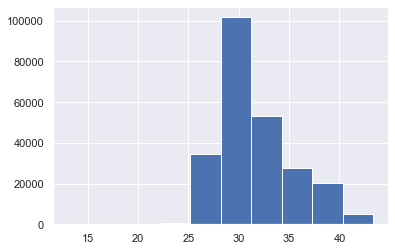

In [69]:
plt.hist((5/9*(pa_cleaned['current_temp_f']-32)))

In [70]:
bam_pa_cleaned_final = pd.merge(pa_cleaned_hourly, bam_cleaned, on='localtime', how='inner')
bam_pa_cleaned_final 

,localtime,current_temp_f,current_humidity,pm2_5_atm,pm2_5_atm_b,Site,AQI,Raw Conc.
0,2020-03-02 12:00:00+00:00,100.952381,45.428571,21.261905,20.744762,Accra,158,51.0
1,2020-03-02 13:00:00+00:00,101.535714,45.142857,31.228214,30.180000,Accra,146,38.0
2,2020-03-02 14:00:00+00:00,101.037037,46.814815,20.125185,19.449630,Accra,137,47.0
3,2020-03-02 15:00:00+00:00,98.750000,50.464286,21.519643,20.726429,Accra,120,36.0
4,2020-03-02 16:00:00+00:00,94.892857,56.464286,23.402857,22.571786,Accra,108,34.0
...,...,...,...,...,...,...,...,...
6665,2020-12-31 20:00:00+00:00,89.107143,59.642857,38.397500,41.474643,Accra,134,53.0
6666,2020-12-31 21:00:00+00:00,88.964286,60.535714,38.893214,41.706786,Accra,135,51.0
6667,2020-12-31 22:00:00+00:00,88.785714,61.035714,45.232857,48.720000,Accra,135,49.0
6668,2020-12-31 23:00:00+00:00,88.793103,61.965517,53.500345,57.103448,Accra,137,54.0


In [71]:
bam_pa_cleaned_final.to_csv("/Volumes/GoogleDrive/My Drive/lcs/lcsdata/bam_pa_cleaned_using_datacleaner.csv")

In [72]:
pa_cleaned_daily = pa_cleaned.resample('D', on='localtime').mean()
pa_cleaned_daily = pa_cleaned_daily[pa_cleaned_daily['pm2_5_atm'].notna()]
pa_cleaned_daily

,current_temp_f,current_humidity,pm2_5_atm,pm2_5_atm_b
localtime,,,,
2019-07-31 00:00:00+00:00,81.210526,28.578947,42.312105,42.822632
2019-08-01 00:00:00+00:00,82.909091,29.000000,10.384091,12.540455
2020-03-02 00:00:00+00:00,93.774096,56.162651,33.204639,32.497169
2020-03-03 00:00:00+00:00,89.065282,59.623145,50.339392,49.424614
2020-03-04 00:00:00+00:00,92.167656,55.255193,40.674629,39.901766
...,...,...,...,...
2021-03-01 00:00:00+00:00,92.864686,55.646865,31.194719,35.019109
2021-03-02 00:00:00+00:00,94.052980,55.567881,36.623725,41.010662
2021-03-03 00:00:00+00:00,94.057283,55.718494,31.911260,35.601702


In [73]:
bam_cleaned_daily = bam_cleaned[bam_cleaned['Raw Conc.'].notna()].resample('D', on='localtime').mean()
bam_cleaned_daily

,AQI,Raw Conc.
localtime,,
2020-01-30 00:00:00+00:00,153.833333,60.166667
2020-01-31 00:00:00+00:00,156.291667,66.083333
2020-02-01 00:00:00+00:00,152.750000,61.791667
2020-02-02 00:00:00+00:00,148.000000,55.625000
2020-02-03 00:00:00+00:00,143.500000,56.000000
...,...,...
2020-12-28 00:00:00+00:00,117.208333,42.458333
2020-12-29 00:00:00+00:00,113.208333,40.625000
2020-12-30 00:00:00+00:00,124.000000,44.875000


In [74]:
bam_pa_cleaned_final_daily = pd.merge(pa_cleaned_daily, bam_cleaned_daily, on='localtime', how='inner')
bam_pa_cleaned_final_daily

,current_temp_f,current_humidity,pm2_5_atm,pm2_5_atm_b,AQI,Raw Conc.
localtime,,,,,,
2020-03-02 00:00:00+00:00,93.774096,56.162651,33.204639,32.497169,124.208333,48.333333
2020-03-03 00:00:00+00:00,89.065282,59.623145,50.339392,49.424614,129.000000,46.708333
2020-03-04 00:00:00+00:00,92.167656,55.255193,40.674629,39.901766,104.842105,36.210526
2020-03-05 00:00:00+00:00,93.229197,56.261314,31.990058,31.413139,92.208333,32.583333
2020-03-06 00:00:00+00:00,91.158358,55.806452,48.794956,47.809208,118.583333,45.458333
...,...,...,...,...,...,...
2020-12-28 00:00:00+00:00,92.146269,55.264179,58.592433,62.383731,117.208333,42.458333
2020-12-29 00:00:00+00:00,92.073025,55.439642,55.997466,59.904724,113.208333,40.625000
2020-12-30 00:00:00+00:00,92.243685,56.436850,61.450446,65.889198,124.000000,44.875000


In [75]:
 bam_pa_cleaned_final_daily.to_csv("/Volumes/GoogleDrive/My Drive/lcs/lcsdata/bam_pa_cleaned_daily_using_datacleaner.csv")

In [77]:
# import data
path = "/Volumes/GoogleDrive/My Drive/lcs/lcsdata/bam_pa_cleaned_daily_using_datacleaner.csv"
data = pd.read_csv(path, header = 0, index_col = 0)
data['temp_f'] = data['current_temp_f']
data['temp_c'] = (data['current_temp_f'] - 32) * (5.0/9)
#data = data.rename(columns={"pm2_5_atm": "purpleair_pm2.5", "Raw Conc.": "embassy_pm2.5", 'current_temp_f':'avg_temp','current_humidity':'RH'})
data = data.rename(columns={"pm2_5_atm": "purpleair_pm2.5", "Raw Conc.": "embassy_pm2.5", 'temp_c':'avg_temp','current_humidity':'RH'})


# subset just to get columns for model
model_data = data[["purpleair_pm2.5", "avg_temp", "RH", "embassy_pm2.5"]]

In [78]:
train_, test_ = train_test_split(model_data, test_size = 0.2, random_state = 13)

gmm = GMM(n_components = 4, random_state = 11)
gmm.from_samples(train_.to_numpy())

Y = gmm.predict(np.array([0,1,2]), test_[["purpleair_pm2.5", "avg_temp", "RH"]].to_numpy())

print(r2_score(Y, test_[["embassy_pm2.5"]].to_numpy()))
print(mean_absolute_error(Y, test_[["embassy_pm2.5"]].to_numpy()))

0.8071658448795421
2.1401584331072674


In [79]:
Y = gmm.predict(np.array([0,1,2]), model_data[["purpleair_pm2.5", "avg_temp", "RH"]].to_numpy())


Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

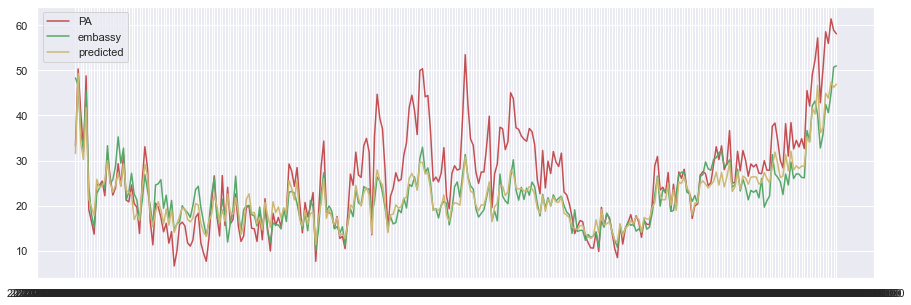

In [80]:
plt.figure(figsize=(15,5))

plt.plot(model_data.index,model_data['purpleair_pm2.5'], 'r-', label='PA')
plt.plot(model_data.index,model_data['embassy_pm2.5'], 'g-', label='embassy')
plt.plot(model_data.index, Y, 'y-', label='predicted')
plt.legend()
plt.show()

In [81]:
model_data['PA_gmr_prediction'] = Y
model_data.to_csv('/Volumes/GoogleDrive/My Drive/lcs/lcsdata/bam_pa_cleaned_with_gmr_predictions.csv')

In [82]:
Y_clarity = gmm.predict(np.array([0,1,2]), clarity_cleaned_data.to_numpy())


In [83]:
clarity_cleaned['gmr_predicted'] = Y_clarity
clarity_cleaned

,localtime,stationName,stationId,nodeId,aqi,pm2_5MassConcRaw[ug/m3],pm2_5MassConcCalib[ug/m3],internalTemperature[degC],internalRelHumidity[%],gmr_predicted
0,2019-01-01 05:00:00+00:00,East Legon,AK06MKD9,AK06MKD9,160.0,72.88,NaN,29.05,75.50,38.558404
1,2019-01-01 05:00:00+00:00,East Legon,AR8160P8,AR8160P8,161.0,74.22,NaN,28.54,77.90,38.840772
2,2019-01-01 05:00:00+00:00,Achimota Interchange,A515QB33,A515QB33,175.0,101.12,NaN,29.23,74.12,50.594484
3,2019-01-01 05:00:00+00:00,Jamestown,A4ZTW82Y,A4ZTW82Y,193.0,137.06,NaN,29.37,77.52,65.591988
4,2019-01-01 05:00:00+00:00,Amasaman,A0C2V9DG,A0C2V9DG,160.0,72.82,NaN,25.33,83.59,37.010706
...,...,...,...,...,...,...,...,...,...,...
837397,2019-01-01 05:00:00+00:00,Odorkor,AW0DBKDH,AW0DBKDH,190.0,130.44,NaN,29.26,72.20,63.074058
837398,2019-01-01 05:00:00+00:00,East Legon,AR8160P8,AR8160P8,161.0,74.22,NaN,28.54,77.90,38.840772
837399,2019-01-01 05:00:00+00:00,East Legon,AK06MKD9,AK06MKD9,160.0,72.88,NaN,29.05,75.50,38.558404
837400,2019-01-01 05:00:00+00:00,Amasaman,A0C2V9DG,A0C2V9DG,160.0,72.82,NaN,25.33,83.59,37.010706


In [84]:
 clarity_cleaned.to_csv('/Volumes/GoogleDrive/My Drive/lcs/lcsdata/clarity_cleaned_with_gmr_predictions_redone.csv')